## NeurIPS Generate Spins (BHA2)

### Imports

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from env.imports import *

/ext3/miniconda3/lib/python3.11/site-packages/pandas/core/arrays/masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (
2025-05-11 23:37:29.011588: I tensorflow/core/util/port.cc:113] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-05-11 23:37:30.556214: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2025-05-11 23:37:32.308769: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
  import numpy.matlib as npm

  au

#### Check job specs

In [ ]:
print_system_usage()

total = psutil.disk_usage('/').total
print(bytes2human(total))

CPU Usage: 0.1%
RAM Usage: 2.9%
Available RAM: 977.4G
Total RAM: 1007.0G
52.4G


In [ ]:
print(os.environ.get("CUDA_VISIBLE_DEVICES"))

# Check available GPUs
print(f"Available GPUs: {torch.cuda.device_count()}")

for i in range(torch.cuda.device_count()):
    print(f"GPU {i}: {torch.cuda.get_device_name(i)} - Memory Allocated: {torch.cuda.memory_allocated(i)/1024**3:.2f} GB")


None
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.00 GB


In [ ]:
import torch; print(torch.__version__)

2.4.1+cu121


### Data viz

In [7]:
from data.data_load import load_transcriptome, load_connectome, load_coords, load_network_labels
from data.data_viz import plot_connectome, plot_transcriptome
from data.data_utils import expand_X_symmetric, expand_Y_symmetric

In [8]:
X = load_transcriptome(parcellation='iPA_391', hemisphere='both', omit_subcortical=False, sort_genes='refgenome', impute_strategy='mirror_interpolate')
Y = load_connectome(parcellation='iPA_391', hemisphere='both', omit_subcortical=False)
coords = load_coords(parcellation='iPA_391', hemisphere='both', omit_subcortical=False)
labels, network_labels = load_network_labels(parcellation='iPA_391', hemisphere='both', omit_subcortical=False)

In [ ]:
X

array([[0.57216899, 0.51116188, 0.56966885, ..., 0.70690349, 0.2708913 ,
        0.47060881],
       [0.58350998, 0.44736111, 0.2815097 , ..., 0.75003086, 0.28676816,
        0.46388351],
       [0.41352207, 0.46335466, 0.46829506, ..., 0.59618146, 0.39315003,
        0.52439154],
       ...,
       [0.33042921, 0.52265523, 0.61861458, ..., 0.26270337, 0.63443332,
        0.57799561],
       [0.26933465, 0.13287993, 0.9604412 , ..., 0.20298951, 0.71072843,
        0.69747636],
       [0.35590877, 0.17368575, 0.85271181, ..., 0.25442639, 0.65409186,
        0.58614136]])

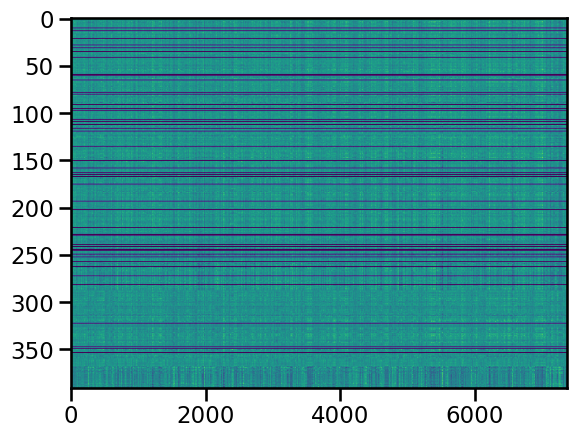

In [ ]:
plt.imshow(np.nan_to_num(X, nan=0), aspect='auto')

### Spatial autocorr analysis

In [11]:
from sim.null import *

Number of components for 95% variance PCA: 105


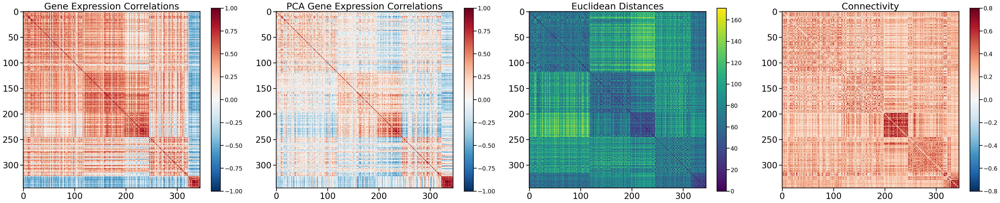

In [12]:
X, X_pca, Y, coords, labels, network_labels, X_corr, X_pca_corr, dist_matrix = load_and_plot_data(parcellation='iPA_391', hemisphere='both', omit_subcortical=False, 
                      sort_genes='expression', impute_strategy='mirror_interpolate', null_model='none', fontsize=26)

features, features_cortex, features_subcortex = subset_brain_data(X, X_pca, Y, coords, labels, network_labels, X_corr, X_pca_corr, dist_matrix)

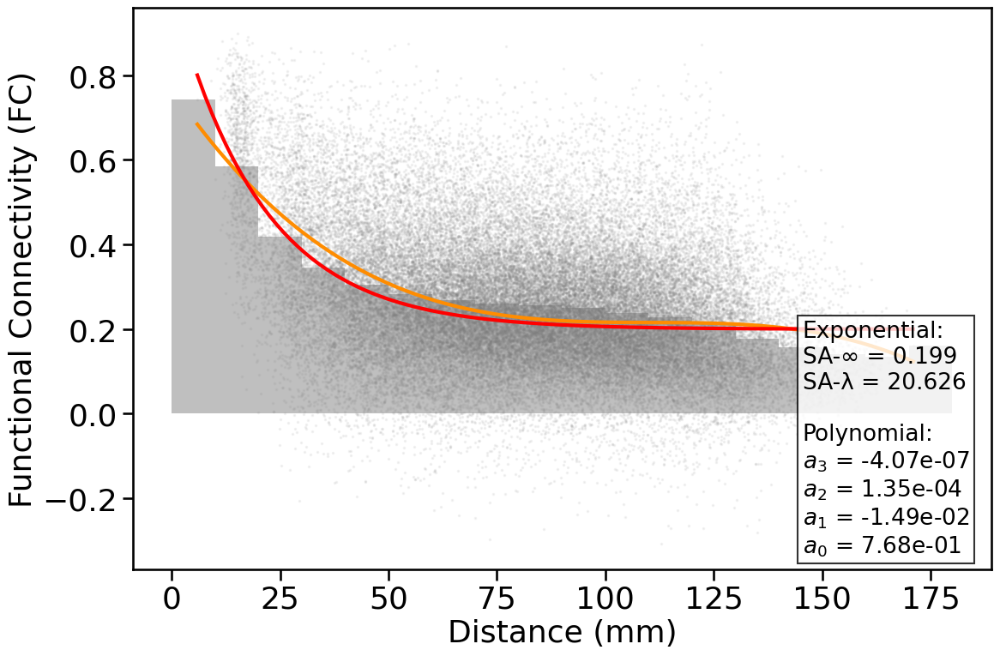

In [13]:
plot_distance_fits(features, 'FC', 10, 'Full Brain')

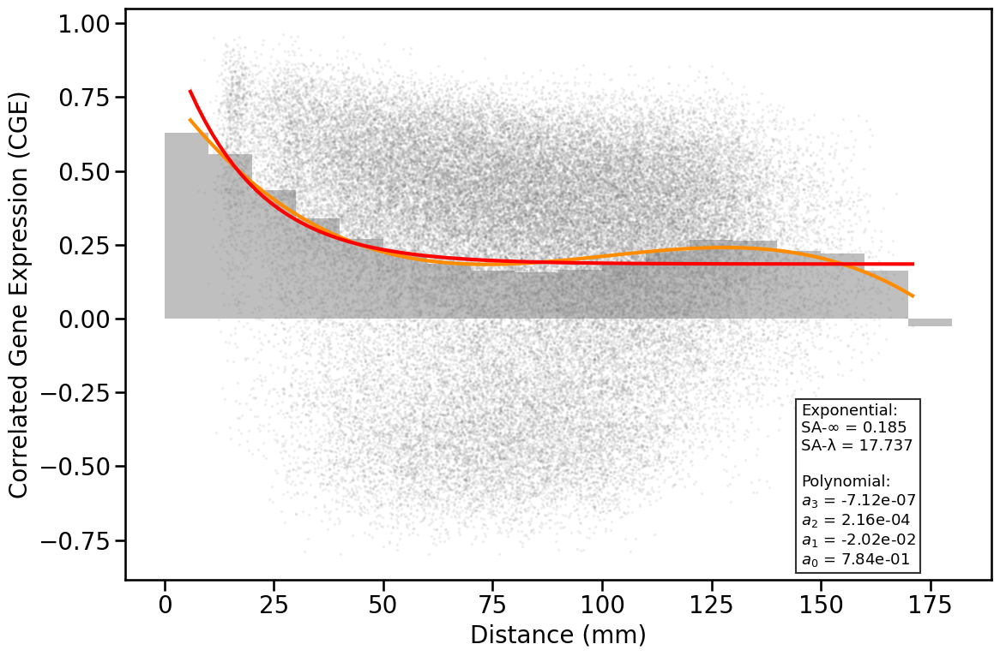

In [14]:
plot_distance_fits(features, 'CGE', 10, 'Full Brain', fontsize=22)


Shapes:
Y_pred_gaussian_kernel: (345, 345)
Y_pred_exponential_decay: (345, 345)
Y_pred_CGE: (345, 345)
Y_pred_PCA_CGE: (345, 345)

Ranges:
Y_pred_gaussian_kernel: [0.000, 1.000]
Y_pred_exponential_decay: [0.200, 1.000]
Y_pred_CGE: [-0.797, 1.000]
Y_pred_PCA_CGE: [-0.834, 1.000]


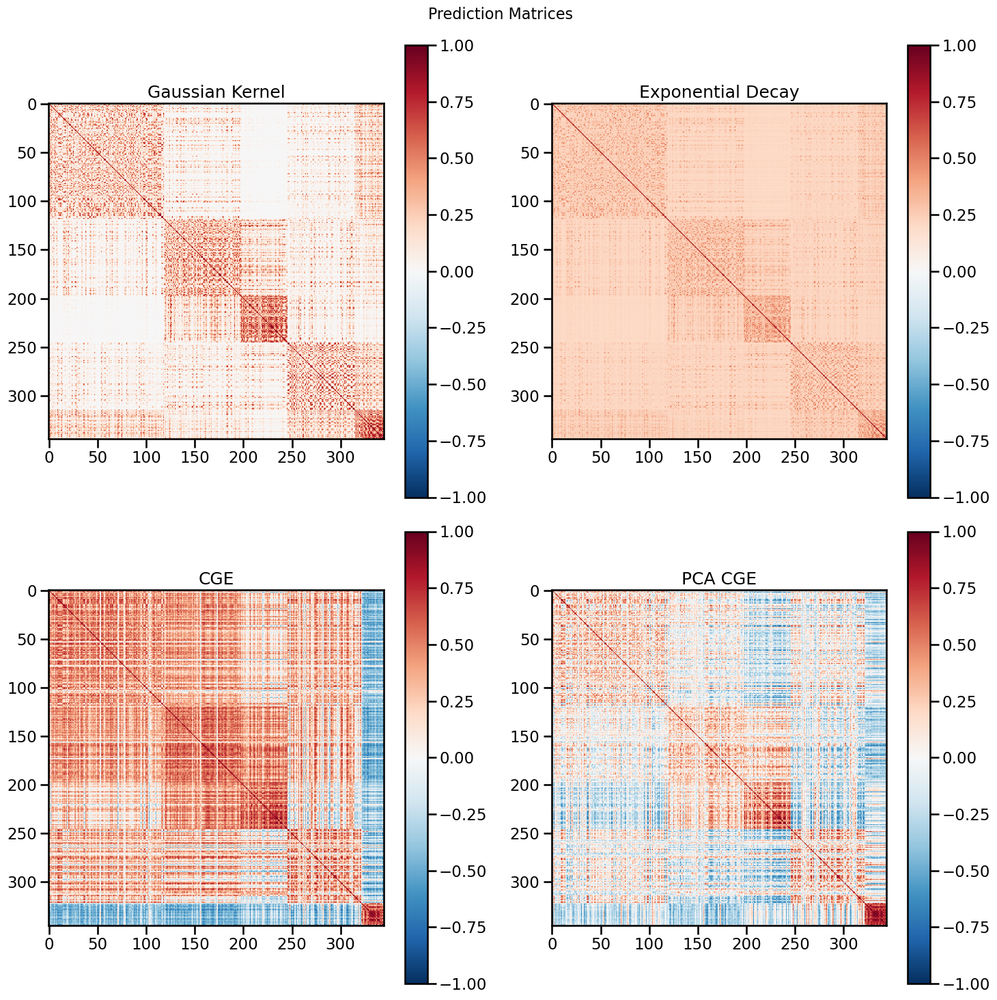

Y_pred_gaussian_kernel: (118680,)
Y_pred_exponential_decay: (118680,)
Y_pred_CGE: (118680,)
Y_pred_PCA_CGE: (118680,)
Y: (118680,)
dist_matrix: (118680,)
                   Model  Pearson-r        R²       MSE    Geodesic  \
0  Dist. Gaussian Kernel   0.382766 -1.554921  0.059290  141.603304   
1       Dist. Exp. Decay   0.402063  0.136319  0.020043   21.248994   
2                    CGE   0.167768 -4.742486  0.133261   43.546014   
3                PCA CGE   0.255676 -5.843202  0.158804  485.295968   

   Short-range r  Mid-range r  Long-range r  
0       0.432653     0.081618      0.170977  
1       0.464193     0.086347      0.192915  
2       0.178922     0.125603      0.157722  
3       0.233465     0.144930      0.189832  
\begin{table}
  \caption{Performance comparison of different models on structural connectivity prediction}
  \label{tab:model-comparison}
  \centering
  \small
  \begin{tabular}{lcccccccc}
    \toprule
    Model & Pearson-r & R² & MSE & Geodesic & Short-range 

In [15]:
# Distance
Y_pred_gaussian_kernel = np.exp(-dist_matrix**2 / (2 * np.std(dist_matrix)**2))

Y_pred_exponential_decay = np.zeros_like(dist_matrix)
for i in range(dist_matrix.shape[0]):
    for j in range(dist_matrix.shape[1]):
        Y_pred_exponential_decay[i,j] = exp_decay(dist_matrix[i,j], 0.2, 21)

# CGE
Y_pred_CGE = X_corr
Y_pred_PCA_CGE = X_pca_corr

# Print shapes
print("Shapes:")
print(f"Y_pred_gaussian_kernel: {Y_pred_gaussian_kernel.shape}")
print(f"Y_pred_exponential_decay: {Y_pred_exponential_decay.shape}")
print(f"Y_pred_CGE: {Y_pred_CGE.shape}")
print(f"Y_pred_PCA_CGE: {Y_pred_PCA_CGE.shape}")

# Print ranges
print("\nRanges:")
print(f"Y_pred_gaussian_kernel: [{Y_pred_gaussian_kernel.min():.3f}, {Y_pred_gaussian_kernel.max():.3f}]")
print(f"Y_pred_exponential_decay: [{Y_pred_exponential_decay.min():.3f}, {Y_pred_exponential_decay.max():.3f}]")
print(f"Y_pred_CGE: [{Y_pred_CGE.min():.3f}, {Y_pred_CGE.max():.3f}]")
print(f"Y_pred_PCA_CGE: [{Y_pred_PCA_CGE.min():.3f}, {Y_pred_PCA_CGE.max():.3f}]")

# Plot each prediction matrix with consistent colormap and scale
fig, axes = plt.subplots(2, 2, figsize=(15, 15))
fig.suptitle('Prediction Matrices', fontsize=16)

# Create a consistent colormap and normalization
cmap = plt.cm.RdBu_r
norm = plt.Normalize(vmin=-1, vmax=1)

# Plot gaussian kernel
im0 = axes[0,0].imshow(Y_pred_gaussian_kernel, cmap=cmap, norm=norm)
axes[0,0].set_title('Gaussian Kernel')
plt.colorbar(im0, ax=axes[0,0])

# Plot exponential decay
im1 = axes[0,1].imshow(Y_pred_exponential_decay, cmap=cmap, norm=norm)
axes[0,1].set_title('Exponential Decay') 
plt.colorbar(im1, ax=axes[0,1])

# Plot CGE
im2 = axes[1,0].imshow(Y_pred_CGE, cmap=cmap, norm=norm)
axes[1,0].set_title('CGE')
plt.colorbar(im2, ax=axes[1,0])

# Plot PCA CGE
im3 = axes[1,1].imshow(Y_pred_PCA_CGE, cmap=cmap, norm=norm)
axes[1,1].set_title('PCA CGE')
plt.colorbar(im3, ax=axes[1,1])

plt.tight_layout()
plt.show()


from models.metrics.eval import * 
import models.metrics.distance_FC


def get_distance_based_correlations(distances, y_true, y_pred):
    """
    Calculate correlations for different distance ranges.
    """
    # Calculate fixed distance cutoffs for short/mid/long range
    dist_min = 0
    dist_max = 175
    dist_range = dist_max - dist_min
    dist_33 = dist_min + (dist_range / 3)
    dist_67 = dist_min + (2 * dist_range / 3)
    
    # Create masks for different ranges
    short_mask = distances <= dist_33
    mid_mask = (distances > dist_33) & (distances <= dist_67)
    long_mask = distances > dist_67
    
    # Calculate correlations for each range
    overall_corr = pearsonr(y_true, y_pred)[0]
    short_range_corr = pearsonr(y_true[short_mask], y_pred[short_mask])[0]
    mid_range_corr = pearsonr(y_true[mid_mask], y_pred[mid_mask])[0]
    long_range_corr = pearsonr(y_true[long_mask], y_pred[long_mask])[0]
    
    return overall_corr, short_range_corr, mid_range_corr, long_range_corr

    print("Shapes:")
# Remove diagonal and flatten each matrix
Y_pred_gaussian_kernel_flat = Y_pred_gaussian_kernel[~np.eye(Y_pred_gaussian_kernel.shape[0], dtype=bool)].flatten()
Y_pred_exponential_decay_flat = Y_pred_exponential_decay[~np.eye(Y_pred_exponential_decay.shape[0], dtype=bool)].flatten()
Y_pred_CGE_flat = Y_pred_CGE[~np.eye(Y_pred_CGE.shape[0], dtype=bool)].flatten()
Y_pred_PCA_CGE_flat = Y_pred_PCA_CGE[~np.eye(Y_pred_PCA_CGE.shape[0], dtype=bool)].flatten()
Y_flat = Y[~np.eye(Y.shape[0], dtype=bool)].flatten()
dist_matrix_flat = dist_matrix[~np.eye(dist_matrix.shape[0], dtype=bool)].flatten()

print(f"Y_pred_gaussian_kernel: {Y_pred_gaussian_kernel_flat.shape}")
print(f"Y_pred_exponential_decay: {Y_pred_exponential_decay_flat.shape}")
print(f"Y_pred_CGE: {Y_pred_CGE_flat.shape}")
print(f"Y_pred_PCA_CGE: {Y_pred_PCA_CGE_flat.shape}")
print(f"Y: {Y_flat.shape}")
print(f"dist_matrix: {dist_matrix_flat.shape}")

# Create empty dataframe with metrics columns
metrics_df = pd.DataFrame(columns=['Model', 'Pearson-r', 'R²', 'MSE', 'Geodesic', 'Short-range r', 'Mid-range r', 'Long-range r'])

# Calculate metrics for Gaussian Kernel model
overall_r_gauss, short_r_gauss, mid_r_gauss, long_r_gauss = get_distance_based_correlations(
    dist_matrix_flat, Y_flat, Y_pred_gaussian_kernel_flat)
r2_gauss = r2_score(Y_flat, Y_pred_gaussian_kernel_flat)
mse_gauss = mean_squared_error(Y_flat, Y_pred_gaussian_kernel_flat)
geodesic_gauss = distance_FC(Y, Y_pred_gaussian_kernel).geodesic()

# Add Gaussian Kernel results
metrics_df.loc[0] = ['Dist. Gaussian Kernel', overall_r_gauss, r2_gauss, mse_gauss, geodesic_gauss,
                     short_r_gauss, mid_r_gauss, long_r_gauss]

# Calculate metrics for Exponential Decay model  
overall_r_exp, short_r_exp, mid_r_exp, long_r_exp = get_distance_based_correlations(
    dist_matrix_flat, Y_flat, Y_pred_exponential_decay_flat)
r2_exp = r2_score(Y_flat, Y_pred_exponential_decay_flat)
mse_exp = mean_squared_error(Y_flat, Y_pred_exponential_decay_flat)
geodesic_exp = distance_FC(Y, Y_pred_exponential_decay).geodesic()

# Add Exponential Decay results
metrics_df.loc[1] = ['Dist. Exp. Decay', overall_r_exp, r2_exp, mse_exp, geodesic_exp,
                     short_r_exp, mid_r_exp, long_r_exp]

# Calculate metrics for CGE model
overall_r_cge, short_r_cge, mid_r_cge, long_r_cge = get_distance_based_correlations(
    dist_matrix_flat, Y_flat, Y_pred_CGE_flat)
r2_cge = r2_score(Y_flat, Y_pred_CGE_flat)
mse_cge = mean_squared_error(Y_flat, Y_pred_CGE_flat)
geodesic_cge = distance_FC(Y, Y_pred_CGE).geodesic()

# Add CGE results
metrics_df.loc[2] = ['CGE', overall_r_cge, r2_cge, mse_cge, geodesic_cge,
                     short_r_cge, mid_r_cge, long_r_cge]

# Calculate metrics for PCA CGE model
overall_r_pca, short_r_pca, mid_r_pca, long_r_pca = get_distance_based_correlations(
    dist_matrix_flat, Y_flat, Y_pred_PCA_CGE_flat)
r2_pca = r2_score(Y_flat, Y_pred_PCA_CGE_flat)
mse_pca = mean_squared_error(Y_flat, Y_pred_PCA_CGE_flat)
geodesic_pca = distance_FC(Y, Y_pred_PCA_CGE).geodesic()

# Add PCA CGE results
metrics_df.loc[3] = ['PCA CGE', overall_r_pca, r2_pca, mse_pca, geodesic_pca,
                     short_r_pca, mid_r_pca, long_r_pca]

print(metrics_df)

# Format metrics to 3 decimal places
formatted_metrics = metrics_df.copy()
formatted_metrics.iloc[:,1:] = formatted_metrics.iloc[:,1:].applymap(lambda x: f"{x:.3f}")

# Create LaTeX table
latex_table = """\\begin{table}
  \\caption{Performance comparison of different models on structural connectivity prediction}
  \\label{tab:model-comparison}
  \\centering
  \\small
  \\begin{tabular}{lcccccccc}
    \\toprule
    Model & Pearson-r & R² & MSE & Geodesic & Short-range r & Mid-range r & Long-range r \\\\
    \\midrule"""

# Find best and second best values for each metric column
best_values = {}
second_best_values = {}
for col in metrics_df.columns[1:]:  # Skip Model column
    values = metrics_df[col].values
    if col in ['MSE', 'Geodesic']:  # For these metrics, lower is better
        best_values[col] = min(values)
        second_best_values[col] = sorted(values)[1]
    else:  # For other metrics, higher is better
        best_values[col] = max(values)
        second_best_values[col] = sorted(values, reverse=True)[1]

# Add each row
for _, row in formatted_metrics.iterrows():
    model_name = row['Model']
    latex_row = [model_name]
    
    for col in formatted_metrics.columns[1:]:
        value = row[col]
        numeric_val = float(value)
        if numeric_val == best_values[col]:
            value = "\\textbf{" + value + "}"
        elif numeric_val == second_best_values[col]:
            value = "\\textit{" + value + "}"
        latex_row.append(value)
        
    latex_table += "\n    " + " & ".join(latex_row) + " \\\\"

latex_table += """
    \\bottomrule
  \\end{tabular}
\\end{table}"""

print(latex_table)


### Create null spin tests

Number of components for 95% variance PCA: 105
[0. 1. 1. 1. 0. 1. 0. 1. 1. 0. 1. 1. 1. 1. 0. 0. 1. 0. 0. 1. 0. 1. 0. 0.
 0. 1. 1. 1. 0. 0. 1. 0. 0. 1. 1. 0. 1. 1. 0. 0. 0. 0. 1. 1. 0. 0. 0. 1.
 0. 1. 1. 1. 0. 1. 1. 0. 1. 1. 0. 1. 0. 1. 0. 0. 1. 1. 0. 1. 0. 1. 0. 0.
 1. 1. 0. 0. 1. 1. 0. 0. 1. 0. 1. 0. 1. 1. 0. 0. 1. 0. 1. 1. 1. 0. 1. 0.
 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 1. 0. 1. 1. 1. 1. 1. 0. 0. 0. 0. 1. 1.
 0. 1. 0. 0. 1. 0. 1. 0. 1. 1. 0. 1. 1. 0. 0. 1. 0. 1. 1. 0. 0. 0. 1. 1.
 0. 1. 0. 1. 1. 0. 1. 0. 1. 1. 0. 0. 1. 1. 1. 0. 0. 0. 1. 1. 1. 0. 0. 1.
 0. 0. 1. 0. 0. 1. 0. 1. 1. 1. 1. 1. 0. 1. 0. 0. 0. 1. 1. 0. 0. 0. 1. 0.
 1. 0. 0. 1. 0. 1. 0. 0. 1. 1. 0. 0. 1. 0. 0. 1. 1. 1. 1. 0. 0. 0. 1. 1.
 1. 0. 1.]
processing spin 0
Number of components for 95% variance PCA: 105


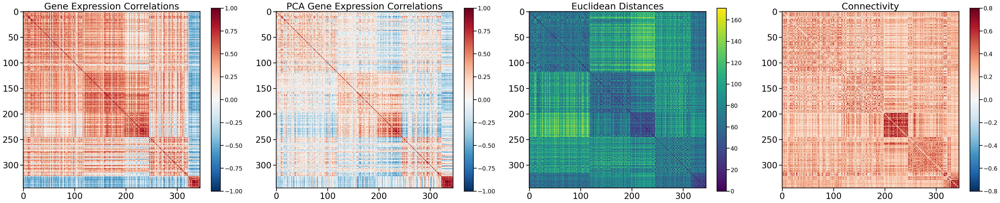

In [17]:
spins_df = generate_null_spins_iPA(n_rotations=10, seed=42 , bin_size_mm=10, parcellation='iPA_391', save_csv=False)

In [18]:
spins_df

,cortical_spins,subcortical_spins,cortical_cost,subcortical_cost,total_cost,mean_error_rank,total_cost_rank,SA_error_rank,poly_error_rank,standardized_SA_error,...,SA_lambda_PCA,SA_inf_PCA,poly_a1,poly_a2,poly_a3,poly_a4,poly_a1_PCA,poly_a2_PCA,poly_a3_PCA,poly_a4_PCA
0,"[58, 21, 159, 62, 144, 91, 35, 85, 24, 54, 118...","[203, 88, 73, 214, 104, 54, 199, 64, 131, 63, ...",10119.563923,20204.193504,30323.757427,4.666667,7.0,4.0,3.0,1.801331,...,4.139609,0.001467,0.602424,-0.014870,0.000183,-7.173620e-07,0.295932,-0.007389,0.000062,-1.956676e-07
1,"[120, 54, 2, 23, 105, 28, 69, 137, 60, 81, 44,...","[217, 8, 88, 209, 29, 33, 213, 61, 25, 79, 207...",10133.714235,25076.484499,35210.198734,4.333333,10.0,2.0,1.0,1.562286,...,3.875214,-0.023724,0.662181,-0.018451,0.000238,-9.600247e-07,0.281439,-0.010125,0.000124,-4.883653e-07
2,"[0, 30, 102, 62, 116, 64, 61, 89, 159, 133, 11...","[32, 112, 25, 113, 184, 8, 60, 1, 107, 39, 80,...",9325.990954,15413.668452,24739.659406,2.333333,4.0,1.0,2.0,0.775617,...,13.192094,-0.008349,0.703560,-0.016098,0.000165,-5.553397e-07,0.617838,-0.018589,0.000166,-4.664698e-07
3,"[55, 27, 145, 0, 11, 165, 2, 101, 161, 75, 73,...","[45, 157, 129, 2, 83, 148, 139, 201, 57, 130, ...",11331.122130,11855.215820,23186.337950,7.666667,3.0,10.0,10.0,4.766694,...,1.798113,0.043662,0.358558,0.000429,-0.000058,3.512587e-07,0.143508,0.002355,-0.000086,4.249233e-07
4,"[110, 92, 124, 169, 51, 143, 2, 55, 10, 114, 7...","[83, 101, 177, 80, 165, 145, 108, 164, 175, 10...",12436.838721,21871.412045,34308.250766,6.333333,8.0,3.0,8.0,1.760723,...,3.629103,-0.016182,0.480929,-0.004756,0.000018,-1.941870e-08,0.256105,-0.005962,0.000051,-1.881951e-07
5,"[105, 49, 104, 70, 54, 111, 47, 5, 124, 120, 7...","[151, 121, 181, 210, 187, 65, 123, 84, 186, 19...",12210.098042,22629.575915,34839.673956,6.000000,9.0,5.0,4.0,2.255917,...,9.020847,-0.039607,0.503693,-0.010672,0.000141,-6.144062e-07,0.415907,-0.012947,0.000136,-4.900209e-07
6,"[126, 114, 145, 62, 64, 4, 102, 28, 117, 90, 1...","[123, 164, 118, 156, 168, 2, 154, 197, 121, 18...",12001.443247,15362.380120,27363.823367,7.666667,6.0,8.0,9.0,4.276866,...,4.486171,0.029187,0.454994,-0.004821,0.000010,1.080244e-07,0.327406,-0.007863,0.000054,-1.045536e-07
7,"[95, 98, 128, 83, 54, 75, 31, 111, 8, 32, 34, ...","[0, 53, 185, 37, 144, 1, 46, 148, 69, 9, 12, 5...",5101.134532,5122.623964,10223.758496,4.333333,1.0,6.0,6.0,2.445063,...,20.272294,-0.072385,0.556356,-0.007622,0.000038,-1.048951e-08,0.615208,-0.015722,0.000123,-3.338192e-07
8,"[123, 154, 145, 85, 160, 112, 65, 3, 19, 40, 6...","[159, 137, 158, 148, 114, 192, 166, 138, 152, ...",12360.017828,9176.382569,21536.400397,6.000000,2.0,9.0,7.0,4.428908,...,5.291236,0.037663,0.469625,-0.008517,0.000070,-1.102099e-07,0.342170,-0.008913,0.000062,-1.001572e-07
9,"[111, 51, 44, 144, 126, 165, 6, 5, 59, 167, 50...","[213, 126, 178, 53, 159, 16, 194, 147, 218, 46...",7839.764103,17916.056740,25755.820843,5.666667,5.0,7.0,5.0,3.390696,...,8.544430,0.029455,0.605972,-0.011618,0.000084,-1.101780e-07,0.508410,-0.016246,0.000148,-3.911585e-07


In [19]:
# Sort spins_df by relevant metric in ascending order
sort_spins = 'mean_error_rank'
spins_df = spins_df.sort_values(sort_spins, ascending=True)

# Get list of indices to use for each null spin
cortical_spins_list = spins_df['cortical_spins'].tolist()
cortical_spin_indices = np.array([np.array(spin) for spin in cortical_spins_list])
print(cortical_spin_indices.shape)

subcortical_spins_list = spins_df['subcortical_spins'].tolist()
subcortical_spin_indices = np.array([np.array(spin) for spin in subcortical_spins_list]) 
print(subcortical_spin_indices.shape)

(10, 172)
(10, 219)


Number of components for 95% variance PCA: 105


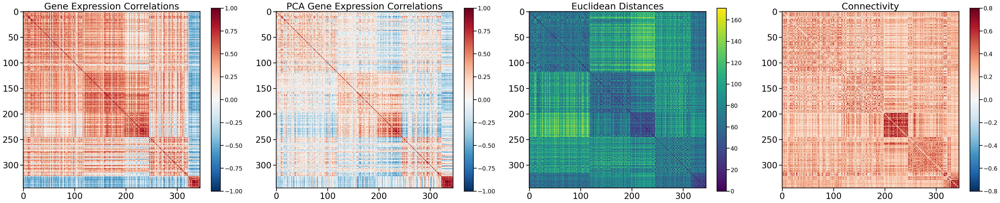

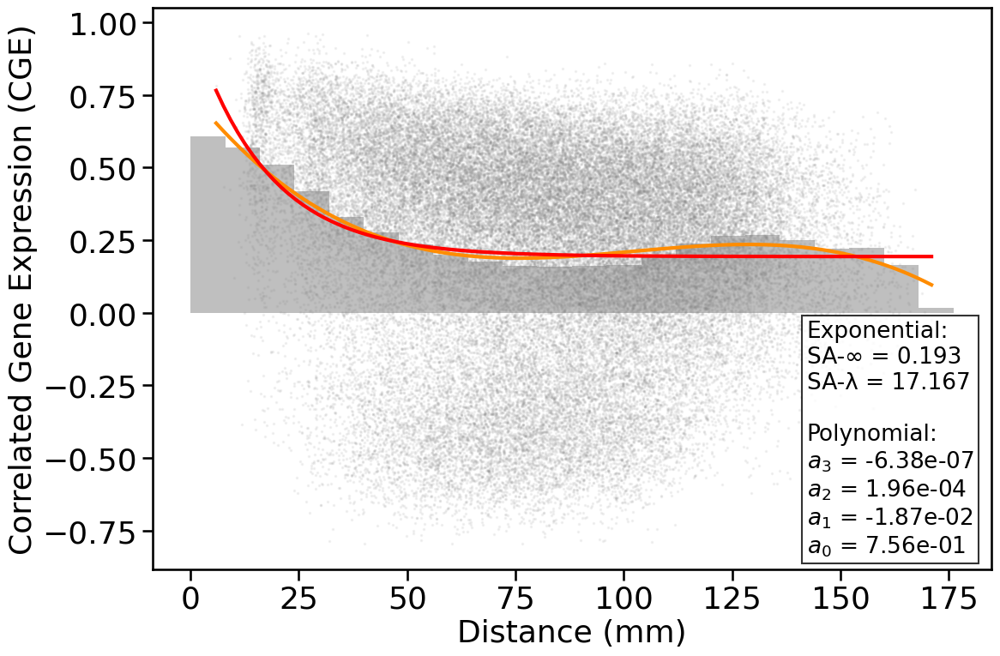

In [22]:
X, X_pca, Y, coords, labels, network_labels, X_corr, X_pca_corr, dist_matrix = load_and_plot_data(parcellation='iPA_391', hemisphere='both', omit_subcortical=False, 
                      sort_genes='expression', impute_strategy='mirror_interpolate', null_model='none', fontsize=26)

features, features_cortex, features_subcortex = subset_brain_data(X, X_pca, Y, coords, labels, network_labels, X_corr, X_pca_corr, dist_matrix)

plot_distance_fits(features, 'CGE', 8, 'Full Brain', fontsize=28)

In [82]:
genes_data = load_transcriptome(parcellation='iPA_183', 
                                             gene_list='0.2',
                                             run_PCA=False, 
                                             omit_subcortical=False, 
                                             hemisphere='both', 
                                             impute_strategy='mirror_interpolate', 
                                             sort_genes='expression', 
                                             return_valid_genes=True, null_model='none', random_seed=42)

genes_data_PCA = load_transcriptome(parcellation='iPA_183', 
                                             gene_list='0.2',
                                             run_PCA=True, 
                                             omit_subcortical=False, 
                                             hemisphere='both', 
                                             impute_strategy='mirror_interpolate', 
                                             sort_genes='expression', 
                                             return_valid_genes=False, null_model='none', random_seed=42)

all_region_coords = load_coords(parcellation='iPA_183', omit_subcortical=False)

num_cortical_regions = 172 # 10 #(genes_data.shape[0] // 100) * 100
cortical_genes_data = genes_data[:num_cortical_regions]
cortical_genes_data_PCA = genes_data_PCA[:num_cortical_regions]

subcortical_genes_data = genes_data[num_cortical_regions:]
subcortical_genes_data_PCA = genes_data_PCA[num_cortical_regions:]

subcortical_coords = all_region_coords[num_cortical_regions:]
x_coords = subcortical_coords[:, 0]
hemi_subcort = np.zeros_like(x_coords) # create mask for subcortical hemisphere
hemi_subcort[x_coords > 0] = 1



Number of components for 95% variance PCA: 54


In [83]:
subcortical_genes_data.shape

(11, 7380)

In [84]:
subcortical_spin_indices.shape


(10, 11)

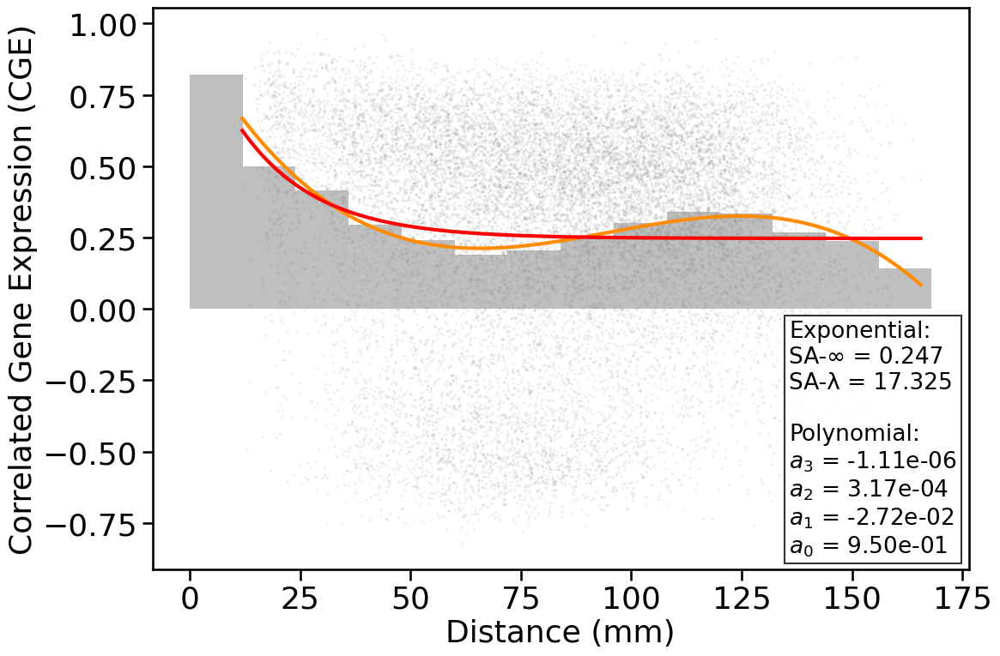

In [88]:
# Best spin
cortical_spin_indices_best = cortical_spin_indices[1, :]
subcortical_spin_indices_best = subcortical_spin_indices[1, :]

cortical_spun_genes_data = cortical_genes_data[:][cortical_spin_indices_best]
subcortical_spun_genes_data = subcortical_genes_data[:][subcortical_spin_indices_best]
spun_genes_data = np.vstack([cortical_spun_genes_data, subcortical_spun_genes_data])

X_corr, CGE_vec, dist_matrix, dist_vec = load_features(spun_genes_data, all_region_coords)
features = {'distances': dist_vec, 'CGE': CGE_vec}

plot_distance_fits(features, 'CGE', bin_size_mm=12, fontsize=28)


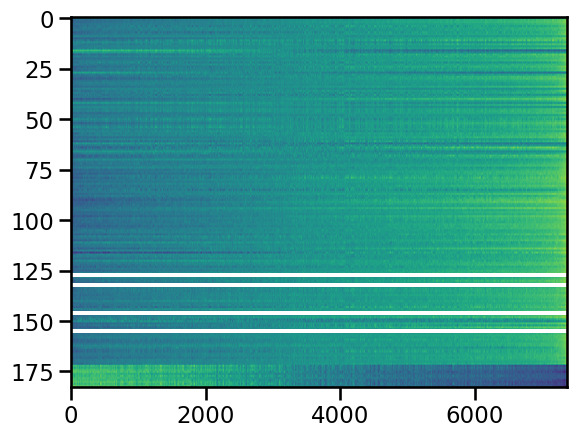

In [89]:
plt.imshow(spun_genes_data, aspect='auto')

In [ ]:
generate_null_spins_iPA(n_rotations=1000, seed=42, bin_size_mm=10, parcellation='iPA_391', save_csv=True)


Number of components for 95% variance PCA: 105


Number of components for 95% variance PCA: 178


[0. 0. 0. 1. 0. 1. 0. 1. 0. 1. 1. 0. 1. 1. 1. 0. 1. 0. 1. 0. 1. 1. 1. 1.
 1. 0. 0. 0. 0. 1. 0. 1. 0. 0. 1. 0. 1. 0. 0. 0. 0. 1. 1. 0. 1. 1. 1. 1.
 0. 1. 0. 1. 0. 1. 0. 0. 1. 0. 1. 0. 1. 0. 1. 0. 1. 1. 1. 1. 0. 1. 1. 1.
 0. 0. 1. 0. 1. 0. 1. 0. 1. 0. 1. 0. 1. 0. 1. 1. 0. 1. 0. 1. 0. 1. 1. 0.
 0. 0. 0. 1. 1. 1. 0. 1. 0. 1. 0. 0. 1. 1. 0. 1. 0. 1. 0. 0. 1. 1. 1. 1.
 0. 1. 0. 0. 1. 0. 0. 1. 1. 0. 0. 1. 0. 0. 1. 0. 1. 1. 0. 0. 0. 1. 1. 0.
 1. 0. 1. 0. 1. 0. 1. 1. 1. 0. 1. 1. 1. 1. 0. 0. 1. 0. 1. 0. 1. 1. 0. 1.
 0. 0. 1. 0. 1. 0. 1. 0. 1. 1. 0. 1. 1. 0. 1. 1. 0. 0. 0. 0. 1. 0. 0. 1.
 0. 0. 1. 1. 0. 1. 1. 1. 0. 0. 0. 1. 1. 1. 0. 1. 0. 0. 1. 1. 0. 0. 0. 1.
 1. 0. 0. 1. 0. 0. 1. 0. 1. 1. 0. 1. 1. 0. 1. 0. 1. 1. 0. 1. 0. 0. 1. 0.
 1. 0. 0. 1. 1. 1. 1. 0. 1. 0. 1. 1. 0. 1. 1. 0. 0. 0. 0. 0. 1. 0. 0. 1.
 0. 1. 0. 0. 0. 0. 1. 1. 1. 1. 0. 0. 0. 1. 1. 1. 0. 1. 1. 0. 1. 1. 0. 1.
 0. 1. 0. 0. 0. 0. 1. 1. 0. 0. 1. 0. 1. 0. 1. 0. 0. 1. 0. 1. 1. 0. 0. 1.
 1. 0. 1. 1. 1. 0. 0. 0. 1. 0. 0. 1. 1. 1. 0. 0. 0.

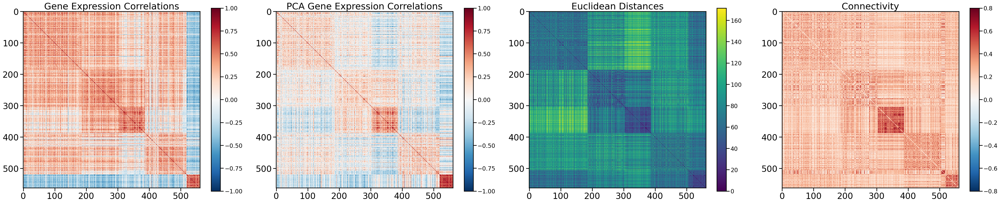

,cortical_spins,subcortical_spins,cortical_cost,subcortical_cost,total_cost,mean_error_rank,total_cost_rank,SA_error_rank,poly_error_rank,standardized_SA_error,...,SA_lambda_PCA,SA_inf_PCA,poly_a1,poly_a2,poly_a3,poly_a4,poly_a1_PCA,poly_a2_PCA,poly_a3_PCA,poly_a4_PCA
0,"[105, 54, 124, 13, 149, 123, 59, 126, 121, 152...","[275, 110, 292, 312, 153, 246, 241, 353, 291, ...",11222.175180,47190.081754,58412.256934,38.000000,67.0,14.0,33.0,7.191516,...,2.916181,0.003374,0.393290,-0.006528,0.000060,-1.841833e-07,0.213414,-0.004324,0.000027,-6.889045e-08
1,"[13, 94, 59, 98, 132, 168, 37, 92, 121, 9, 159...","[354, 145, 296, 113, 351, 295, 202, 308, 350, ...",12646.034324,56257.343322,68903.377646,73.333333,98.0,40.0,82.0,8.397636,...,3.954098,0.027357,0.341259,-0.001974,-0.000020,1.876995e-07,0.259921,-0.006700,0.000047,-8.005051e-08
2,"[22, 143, 17, 55, 51, 137, 80, 85, 24, 160, 47...","[234, 255, 241, 144, 35, 67, 120, 211, 242, 23...",9393.627051,34814.891239,44208.518290,12.000000,24.0,2.0,10.0,5.748426,...,6.860356,-0.008345,0.470653,-0.009719,0.000102,-3.529446e-07,0.390858,-0.011362,0.000107,-3.414278e-07
3,"[133, 5, 61, 144, 139, 152, 150, 107, 84, 101,...","[468, 169, 2, 34, 11, 5, 43, 60, 436, 22, 454,...",11558.152515,30268.539165,41826.691680,71.333333,19.0,99.0,96.0,10.930046,...,2.716868,0.027604,0.313691,0.000306,-0.000055,3.339285e-07,0.193727,-0.001151,-0.000033,2.112705e-07
4,"[90, 3, 16, 1, 45, 62, 31, 55, 66, 143, 71, 16...","[17, 330, 410, 277, 430, 127, 351, 489, 479, 3...",13733.782940,52664.642329,66398.425269,88.666667,93.0,80.0,93.0,9.795431,...,2.755943,0.014935,0.281508,0.000143,-0.000037,2.119620e-07,0.222374,-0.005159,0.000037,-8.877181e-08
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,"[46, 103, 37, 3, 75, 139, 2, 77, 156, 28, 124,...","[237, 239, 129, 144, 149, 127, 175, 86, 138, 2...",11016.583515,43326.199130,54342.782645,25.000000,58.0,13.0,4.0,7.116484,...,4.836972,-0.022625,0.470800,-0.011257,0.000148,-6.385752e-07,0.340233,-0.010524,0.000114,-4.287406e-07
96,"[42, 22, 59, 55, 72, 90, 159, 143, 142, 79, 2,...","[474, 530, 542, 47, 396, 488, 516, 500, 375, 6...",9189.912287,33669.816419,42859.728706,59.000000,22.0,87.0,68.0,10.077283,...,3.179893,0.004414,0.306043,-0.003497,0.000022,-1.638409e-08,0.223177,-0.005623,0.000046,-1.349655e-07
97,"[140, 49, 124, 81, 58, 115, 136, 7, 19, 27, 34...","[161, 135, 212, 183, 2, 10, 185, 164, 85, 14, ...",10166.284674,20684.626397,30850.911071,12.666667,4.0,32.0,2.0,8.076153,...,4.474837,0.003750,0.476201,-0.012130,0.000135,-4.335017e-07,0.324170,-0.009956,0.000097,-3.127827e-07
98,"[143, 154, 66, 95, 15, 78, 6, 168, 93, 162, 16...","[139, 357, 306, 361, 48, 20, 291, 312, 166, 33...",8437.619703,40181.562442,48619.182145,49.333333,37.0,49.0,62.0,8.707146,...,2.838942,0.029110,0.383903,-0.004232,0.000013,4.915472e-08,0.214371,-0.004677,0.000025,-1.784866e-08


In [28]:
generate_null_spins_iPA(n_rotations=1000, seed=42, bin_size_mm=10, parcellation='iPA_729', save_csv=True)

valid genes ['CRNDE', 'ECEL1', 'CHRNA3', 'RSPO4', 'TTR', 'RGS8', 'CA12', 'GINS3', 'KLHL13', 'S100PBP', 'PARD3B', 'PDE3A', 'SIX3', 'SCIN', 'NHSL1', 'BTN2A2', 'PIRT', 'RAB2B', 'SMIM30', 'DRD2', 'LONRF3', 'CYB5R3', 'SLITRK6', 'ELP4', 'HEYL', 'PKNOX1', 'GPRIN2', 'LHX8', 'MEGF11', 'C10orf105', 'AUTS2', 'PDIA3', 'PDIA3P1', 'CPNE3', 'TMEM255A', 'TMEM215', 'CYP7B1', 'IL13RA2', 'GPR75', 'TEAD1', 'KCNE5', 'PDLIM5', 'STAT1', 'C6orf118', 'CYLD', 'BAG3', 'TTPA', 'PINLYP', 'PCDH15', 'PREX2', 'PLXDC2', 'RASL12', 'DERL1', 'SCN7A', 'ARHGAP36', 'DNAJC12', 'AKIRIN2', 'ACVR1', 'ENKUR', 'NPL', 'FLVCR1', 'SAMD11', 'DNAH9', 'ADIPOR1', 'COL8A2', 'MAP3K1', 'LOC100233156', 'ADARB2-AS1', 'PFKFB3', 'SDC2', 'DAB2', 'CASC2', 'RGS22', 'PHKA1', 'HEY2', 'CENPVL3', 'PTGER3', 'CCDC85C', 'YBX3', 'PRSS35', 'VANGL1', 'PLXNA3', 'GLUD1', 'SSR1', 'MLF1', 'FAM210B', 'SERPINB1', 'WDR1', 'CFLAR', 'SZRD1', 'DAPL1', 'SPATA18', 'STK33', 'CFAP61', 'MAML2', 'DIRC2', 'ZNF516', 'MINK1', 'FAM111A', 'LINC01485', 'SCN9A', 'LINC00886', 'CX

Number of components for 95% variance PCA: 27
processing spin 0
[ True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True

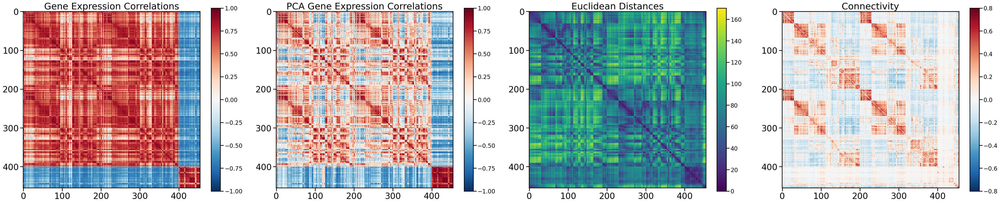

In [16]:
spins_df = generate_null_spins(n_rotations=10, seed=42, bin_size_mm=5, save_csv=False)

In [19]:
spins_df.sort_values('mean_error_rank', ascending=True, inplace=True)
print(spins_df.iloc[:, 4:])
spins_df.head()


     total_cost  mean_error_rank  total_cost_rank  SA_error_rank  \
8  15562.749509         2.333333              2.0            2.0   
2  16259.629432         3.000000              5.0            3.0   
7  10602.778447         3.666667              1.0            4.0   
0  17019.041037         4.333333              8.0            1.0   
3  15885.512724         5.000000              3.0            5.0   
5  17367.524744         6.000000             10.0            6.0   
4  17004.772706         6.333333              7.0            7.0   
9  16753.793741         7.333333              6.0            8.0   
6  16101.034898         8.000000              4.0           10.0   
1  17302.791691         9.000000              9.0            9.0   

   poly_error_rank  standardized_SA_error  standardized_poly_error  \
8              3.0               2.229868                16.665002   
2              1.0               2.993139                12.584043   
7              6.0               3.642935

,cortical_spins,subcortical_spins,cortical_cost,subcortical_cost,total_cost,mean_error_rank,total_cost_rank,SA_error_rank,poly_error_rank,standardized_SA_error,...,SA_lambda_PCA,SA_inf_PCA,poly_a1,poly_a2,poly_a3,poly_a4,poly_a1_PCA,poly_a2_PCA,poly_a3_PCA,poly_a4_PCA
8,"[188, 109, 112, 186, 67, 66, 88, 57, 64, 178, ...","[54, 52, 43, 47, 53, 2, 3, 0, 13, 48, 11, 42, ...",13282.952890,2279.796618,15562.749509,2.333333,2.0,2.0,3.0,2.229868,...,28.863321,-0.041290,0.917226,-0.020471,0.000220,-7.251595e-07,0.855997,-0.023788,0.000226,-7.121803e-07
2,"[165, 166, 124, 167, 114, 125, 133, 119, 113, ...","[54, 55, 32, 46, 48, 50, 3, 29, 5, 31, 30, 34,...",14066.498745,2193.130687,16259.629432,3.000000,5.0,3.0,1.0,2.993139,...,34.530601,-0.104178,0.990390,-0.023210,0.000244,-7.754920e-07,0.969185,-0.029299,0.000301,-1.024482e-06
7,"[12, 15, 4, 21, 10, 17, 19, 14, 199, 146, 190,...","[5, 4, 29, 9, 2, 13, 7, 6, 0, 11, 32, 3, 12, 1...",9737.333676,865.444771,10602.778447,3.666667,1.0,4.0,6.0,3.642935,...,34.193715,-0.067259,0.983020,-0.020343,0.000186,-4.930766e-07,0.923409,-0.021599,0.000158,-3.785851e-07
0,"[34, 35, 33, 102, 101, 99, 140, 152, 100, 174,...","[53, 52, 49, 51, 54, 50, 33, 34, 42, 48, 29, 4...",14676.201766,2342.839271,17019.041037,4.333333,8.0,1.0,4.0,1.942103,...,39.069998,-0.164938,0.892056,-0.020372,0.000229,-7.939946e-07,0.892085,-0.026995,0.000288,-1.034092e-06
3,"[48, 106, 110, 109, 55, 199, 179, 194, 54, 182...","[2, 55, 0, 49, 54, 50, 29, 3, 13, 51, 4, 47, 9...",13520.685713,2364.827011,15885.512724,5.000000,3.0,5.0,7.0,4.956122,...,25.958393,0.007003,0.955965,-0.020002,0.000183,-4.740132e-07,0.908789,-0.023540,0.000193,-4.967189e-07


#### Plot some CGE vs distance decay curves

In [45]:
spins_df = pd.read_csv('./data/enigma/10000_null_spins.csv')

In [46]:
spins_df.dtypes

cortical_spins                  object
subcortical_spins               object
cortical_cost                  float64
subcortical_cost               float64
total_cost                     float64
mean_error_rank                float64
total_cost_rank                float64
SA_error_rank                  float64
poly_error_rank                float64
standardized_SA_error          float64
standardized_poly_error        float64
standardized_SA_PCA_error      float64
standardized_poly_PCA_error    float64
SA_lambda                      float64
SA_inf                         float64
SA_lambda_PCA                  float64
SA_inf_PCA                     float64
poly_a1                        float64
poly_a2                        float64
poly_a3                        float64
poly_a4                        float64
poly_a1_PCA                    float64
poly_a2_PCA                    float64
poly_a3_PCA                    float64
poly_a4_PCA                    float64
pearsonr_SCM             

In [47]:
# Sort spins_df by relevant metric in ascending order
sort_spins = 'mean_error_rank'
spins_df = spins_df.sort_values(sort_spins, ascending=True)

# Get list of indices to use for each null spin
cortical_spins_list = spins_df['cortical_spins'].apply(ast.literal_eval).values
cortical_spin_indices = np.vstack(cortical_spins_list)
print(cortical_spin_indices.shape)

subcortical_spins_list = spins_df['subcortical_spins'].apply(ast.literal_eval).values
subcortical_spin_indices = np.vstack(subcortical_spins_list)
print(subcortical_spin_indices.shape)

(10000, 400)
(10000, 56)


Revisualize true distribution

Number of components for 95% variance PCA: 27


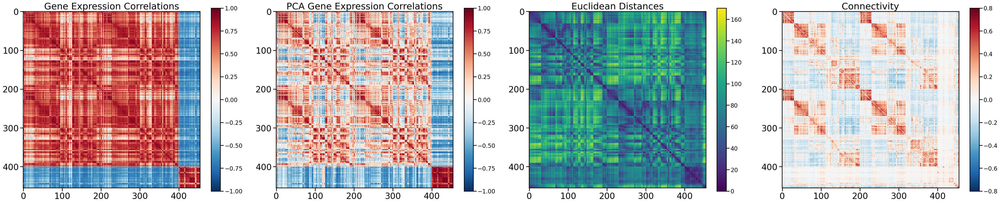

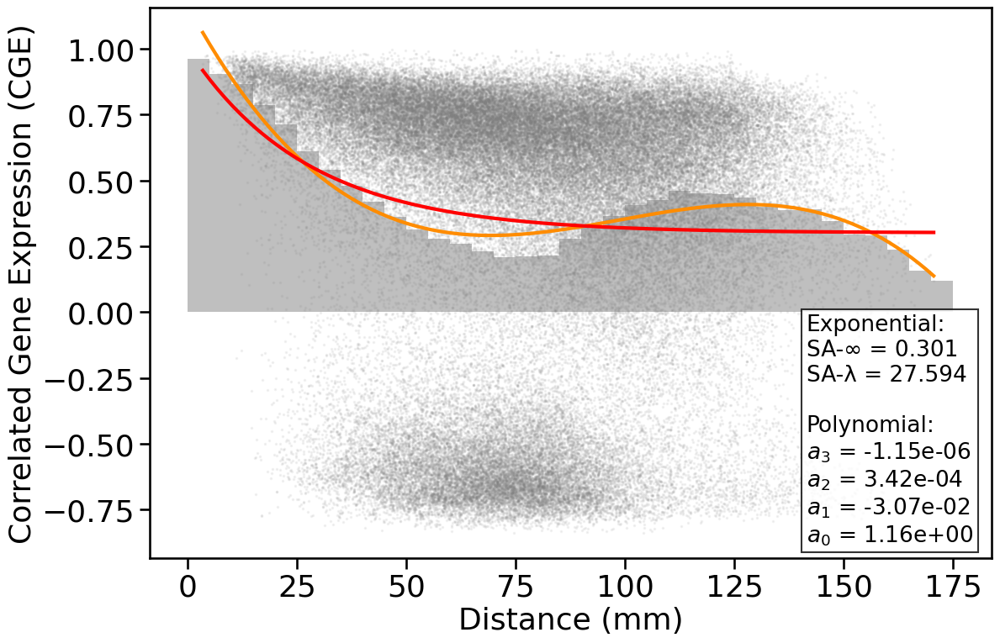

In [84]:
X, X_pca, Y, coords, labels, network_labels, X_corr, X_pca_corr, dist_matrix = load_and_plot_data(parcellation='S400', hemisphere='both', omit_subcortical=False, 
                      sort_genes='expression', impute_strategy='mirror_interpolate', null_model='none', fontsize=26)

features, features_cortex, features_subcortex = subset_brain_data(X, X_pca, Y, coords, labels, network_labels, X_corr, X_pca_corr, dist_matrix)

plot_distance_fits(features, 'CGE', 5, 'Full Brain', fontsize=28)

Reload in raw data to be spun 

In [85]:
genes_data, valid_genes = load_transcriptome(parcellation='S400', 
                                             gene_list='0.2',
                                             run_PCA=False, 
                                             omit_subcortical=False, 
                                             hemisphere='both', 
                                             impute_strategy='mirror_interpolate', 
                                             sort_genes='expression', 
                                             return_valid_genes=True, null_model='none', random_seed=42)

genes_data_PCA = load_transcriptome(parcellation='S400', 
                                             gene_list='0.2',
                                             run_PCA=True, 
                                             omit_subcortical=False, 
                                             hemisphere='both', 
                                             impute_strategy='mirror_interpolate', 
                                             sort_genes='expression', 
                                             return_valid_genes=False, null_model='none', random_seed=42)

all_region_coords = load_coords(parcellation='S400', omit_subcortical=False)

num_cortical_regions = (genes_data.shape[0] // 100) * 100
cortical_genes_data = genes_data[:num_cortical_regions]
cortical_genes_data_PCA = genes_data_PCA[:num_cortical_regions]

subcortical_genes_data = genes_data[num_cortical_regions:]
subcortical_genes_data_PCA = genes_data_PCA[num_cortical_regions:]

subcortical_coords = all_region_coords[num_cortical_regions:]
x_coords = subcortical_coords[:, 0]
hemi_subcort = np.zeros_like(x_coords) # create mask for subcortical hemisphere
hemi_subcort[x_coords > 0] = 1
# drop cerebellum
hemi_subcort = hemi_subcort[:-10]


valid genes ['CRNDE', 'ECEL1', 'CHRNA3', 'RSPO4', 'TTR', 'RGS8', 'CA12', 'GINS3', 'KLHL13', 'S100PBP', 'PARD3B', 'PDE3A', 'SIX3', 'SCIN', 'NHSL1', 'BTN2A2', 'PIRT', 'RAB2B', 'SMIM30', 'DRD2', 'LONRF3', 'CYB5R3', 'SLITRK6', 'ELP4', 'HEYL', 'PKNOX1', 'GPRIN2', 'LHX8', 'MEGF11', 'C10orf105', 'AUTS2', 'PDIA3', 'PDIA3P1', 'CPNE3', 'TMEM255A', 'TMEM215', 'CYP7B1', 'IL13RA2', 'GPR75', 'TEAD1', 'KCNE5', 'PDLIM5', 'STAT1', 'C6orf118', 'CYLD', 'BAG3', 'TTPA', 'PINLYP', 'PCDH15', 'PREX2', 'PLXDC2', 'RASL12', 'DERL1', 'SCN7A', 'ARHGAP36', 'DNAJC12', 'AKIRIN2', 'ACVR1', 'ENKUR', 'NPL', 'FLVCR1', 'SAMD11', 'DNAH9', 'ADIPOR1', 'COL8A2', 'MAP3K1', 'LOC100233156', 'ADARB2-AS1', 'PFKFB3', 'SDC2', 'DAB2', 'CASC2', 'RGS22', 'PHKA1', 'HEY2', 'CENPVL3', 'PTGER3', 'CCDC85C', 'YBX3', 'PRSS35', 'VANGL1', 'PLXNA3', 'GLUD1', 'SSR1', 'MLF1', 'FAM210B', 'SERPINB1', 'WDR1', 'CFLAR', 'SZRD1', 'DAPL1', 'SPATA18', 'STK33', 'CFAP61', 'MAML2', 'DIRC2', 'ZNF516', 'MINK1', 'FAM111A', 'LINC01485', 'SCN9A', 'LINC00886', 'CX

Best mean rank spin

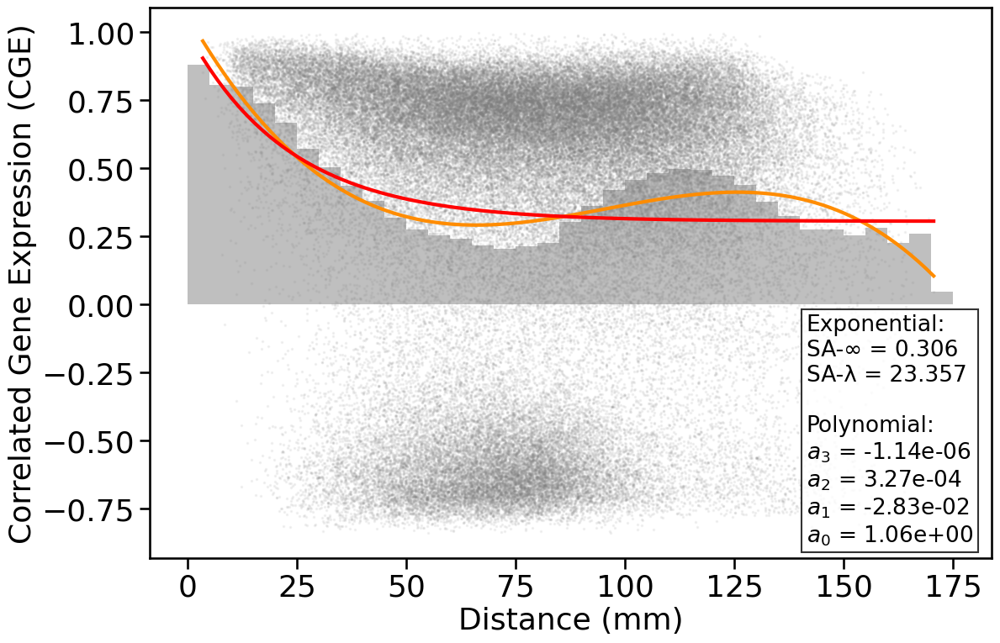

In [95]:
# Best spin
cortical_spin_indices_best = cortical_spin_indices[1, :]
subcortical_spin_indices_best = subcortical_spin_indices[1, :]

cortical_spun_genes_data = cortical_genes_data[:][cortical_spin_indices_best]
subcortical_spun_genes_data = subcortical_genes_data[:][subcortical_spin_indices_best]
spun_genes_data = np.vstack([cortical_spun_genes_data, subcortical_spun_genes_data])
X_corr, CGE_vec, dist_matrix, dist_vec = load_features(spun_genes_data, all_region_coords)
features = {'distances': dist_vec, 'CGE': CGE_vec}

plot_distance_fits(features, 'CGE', bin_size_mm=5, fontsize=28)


Worst mean rank spin

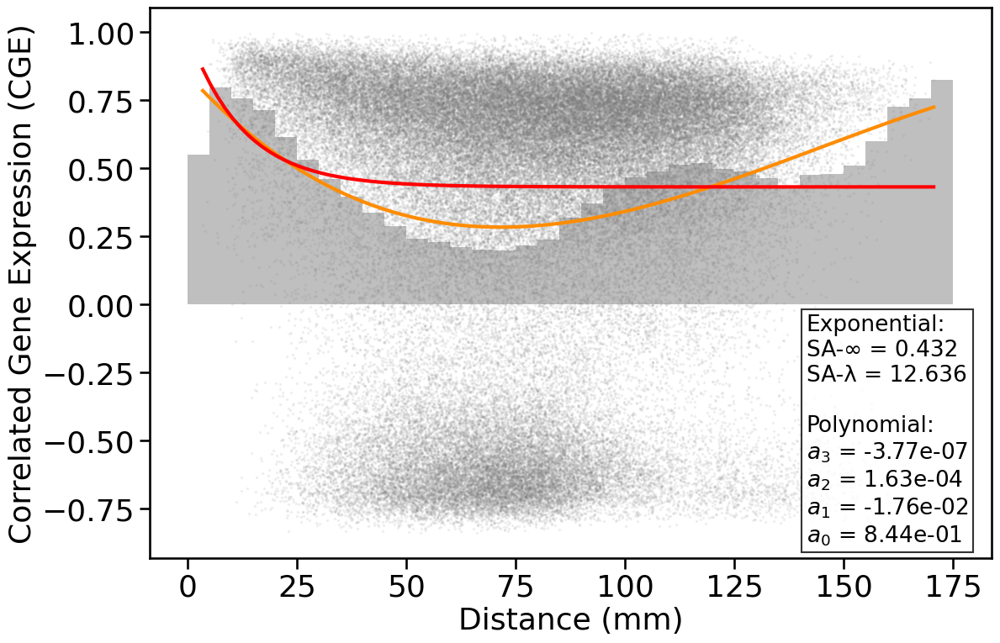

In [88]:
cortical_spin_indices_worst = cortical_spin_indices[-1, :]
subcortical_spin_indices_worst = subcortical_spin_indices[-1, :]

cortical_spun_genes_data = cortical_genes_data[:][cortical_spin_indices_worst]
subcortical_spun_genes_data = subcortical_genes_data[:][subcortical_spin_indices_worst]
spun_genes_data = np.vstack([cortical_spun_genes_data, subcortical_spun_genes_data])
X_corr, CGE_vec, dist_matrix, dist_vec = load_features(spun_genes_data, all_region_coords)
features = {'distances': dist_vec, 'CGE': CGE_vec}

plot_distance_fits(features, 'CGE', bin_size_mm=5, fontsize=28)


Random spin retaining cortical, subcortical, cerebellar spatial layout

In [78]:
'''
# Initialize empty lists to store spins
cortical_spins_list = []
subcortical_spins_list = []

# Iterate 1000 times with different random seeds
for seed in range(1000):
    np.random.seed(seed)
    cortical_spin_indices_random = cortical_spin_indices[seed, :]
    subcortical_spin_indices_random = subcortical_spin_indices[seed, :]

    # Spin hemispheres identically
    cortex_lh_rh_mapping = dict(zip(cortical_spin_indices_random[:200], cortical_spin_indices_random[200:]))

    # Generate permutation in one hemisphere then map to the other hemisphere
    lh_perm = np.random.permutation(np.arange(200))
    rh_perm = np.array([cortex_lh_rh_mapping[x] for x in lh_perm])
    cortical_spin_indices_hemi_random = np.concatenate([lh_perm, rh_perm])

    true_subcort_indices = np.arange(46)
    left_subcort_indices = true_subcort_indices[hemi_subcort == 0]
    right_subcort_indices = true_subcort_indices[hemi_subcort == 1]

    # Define a mapping between left and right subcortical indices
    subcort_lr_mapping = dict(zip(left_subcort_indices, right_subcort_indices))

    # Generate permutation in one hemisphere then map to the other hemisphere
    lh_subcort_perm = np.random.permutation(left_subcort_indices)
    rh_subcort_perm = np.array([subcort_lr_mapping[x] for x in lh_subcort_perm])
    subcortical_spin_indices_hemi_random = np.concatenate([lh_subcort_perm, rh_subcort_perm])

    # Permute cerebellum i.e. 46-56
    cerebellum_perm = np.random.permutation(np.arange(46, 56))
    subcortical_cerebellum_spin_indices_hemi_random = np.concatenate([subcortical_spin_indices_hemi_random, cerebellum_perm])

    # Append spins to lists
    cortical_spins_list.append(cortical_spin_indices_hemi_random.tolist())
    subcortical_spins_list.append(subcortical_cerebellum_spin_indices_hemi_random.tolist())

# Create dataframe
spatial_random_spins_df = pd.DataFrame({
    'cortical_spins': cortical_spins_list,
    'subcortical_spins': subcortical_spins_list
})
'''
# Save spins to CSV
#spatial_random_spins_df.to_csv('./data/enigma/1000_spatial_random_spins.csv', index=False)

In [89]:
spatial_random_spins_df = pd.read_csv('./data/enigma/1000_spatial_random_spins.csv')

(1000, 400)
(1000, 56)


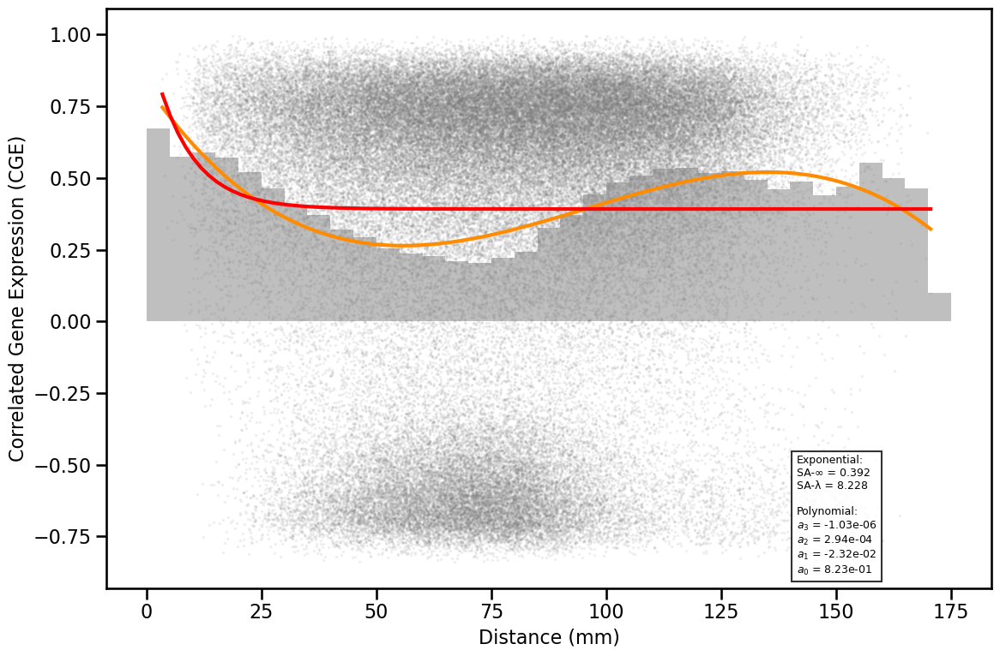

In [90]:
# Get list of indices to use for each null spin
cortical_spins_list = spatial_random_spins_df['cortical_spins'].apply(ast.literal_eval).values
cortical_spin_indices_hemi_random = np.vstack(cortical_spins_list)
print(cortical_spin_indices_hemi_random.shape)

subcortical_spins_list = spatial_random_spins_df['subcortical_spins'].apply(ast.literal_eval).values
subcortical_cerebellum_spin_indices_hemi_random = np.vstack(subcortical_spins_list)
print(subcortical_cerebellum_spin_indices_hemi_random.shape)

seed = 0
cortical_spin_indices_hemi_random = cortical_spin_indices_hemi_random[seed, :]
subcortical_cerebellum_spin_indices_hemi_random = subcortical_cerebellum_spin_indices_hemi_random[seed, :]

cortical_spun_genes_data = cortical_genes_data[:][cortical_spin_indices_hemi_random]
subcortical_spun_genes_data = subcortical_genes_data[:][subcortical_cerebellum_spin_indices_hemi_random]
spun_genes_data = np.vstack([cortical_spun_genes_data, subcortical_spun_genes_data])
X_corr, CGE_vec, dist_matrix, dist_vec = load_features(spun_genes_data, all_region_coords)
features = {'distances': dist_vec, 'CGE': CGE_vec}

plot_distance_fits(features, 'CGE', bin_size_mm=5)


True random

In [91]:
'''
# Initialize empty lists to store spins
true_random_spins_list = []

# Iterate 1000 times with different random seeds
for seed in range(1000):
    np.random.seed(seed)
    # Generate completely random permutation of all indices
    spin_indices_random = np.random.permutation(np.arange(456))
    true_random_spins_list.append(spin_indices_random.tolist())

# Create dataframe
true_random_spins_df = pd.DataFrame({
    'true_random_spins': true_random_spins_list
})
'''
#true_random_spins_df
# true_random_spins_df.to_csv('./data/enigma/1000_true_random_spins.csv', index=False)
true_random_spins_df = pd.read_csv('./data/enigma/1000_true_random_spins.csv')

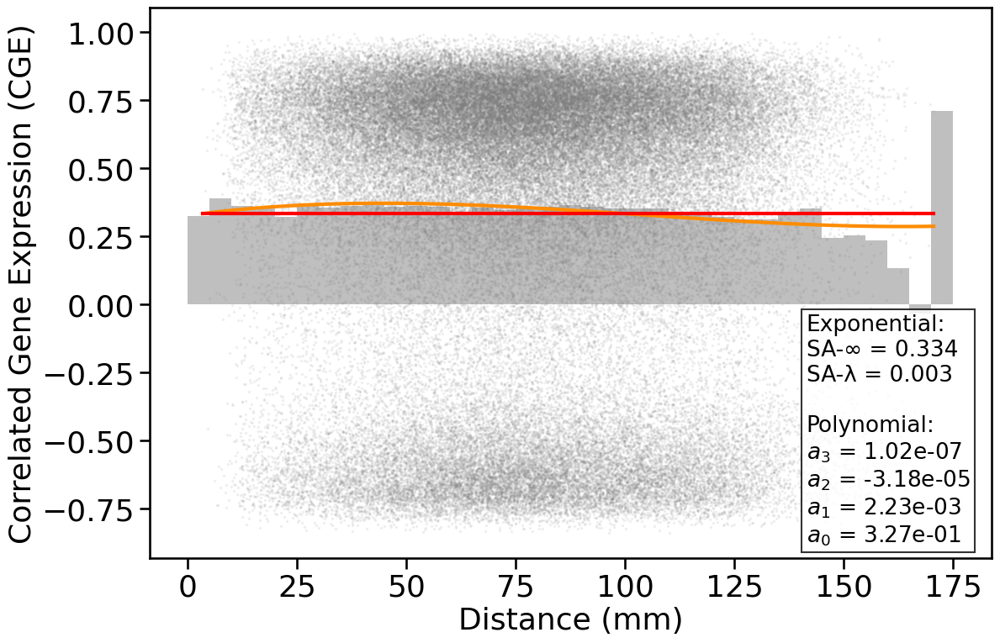

In [94]:
random_seed = 42
spin_indices_random = np.array(true_random_spins_df['true_random_spins'].apply(ast.literal_eval).values[random_seed])
spun_genes_data = genes_data[spin_indices_random]
X_corr, CGE_vec, dist_matrix, dist_vec = load_features(spun_genes_data, all_region_coords)
features = {'distances': dist_vec, 'CGE': CGE_vec}

plot_distance_fits(features, 'CGE', bin_size_mm=5, fontsize=28)
